<a href="https://colab.research.google.com/github/chisouche/pythoncodes/blob/main/yolo_obj.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/yolov5
Setup complete. Using torch 1.10.0+cu111 (Tesla T4)


In [2]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [3]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [4]:
#after following the link above, recieve python code with these fields filled in
rf = Roboflow(api_key="Pxjjuop7dutpthrR13lL")
project = rf.workspace("new-workspace-rakev").project("object_dtect")
dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/object_dtect-1 in yolov5pytorch:: 100%|██████████| 4994/4994 [00:04<00:00, 1187.53it/s]


In [5]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat {dataset.location}/data.yaml

names:
- box
- pallet
- shelf
nc: 3
train: /content/datasets/object_dtect-1/train/images
val: /content/datasets/object_dtect-1/valid/images


In [7]:
!python train.py --img 416 --batch 16 --epochs 100 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/object_dtect-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
remote: Enumerating objects: 5, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 5 (delta 0), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (5/5), done.
From https://github.com/ultralytics/yolov5
 * [new branch]      glenn-jocher-patch-1 -> origin/glenn-jocher-patch-1
github: up to date with https://github.com/ultralytics/yolov5 

In [8]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

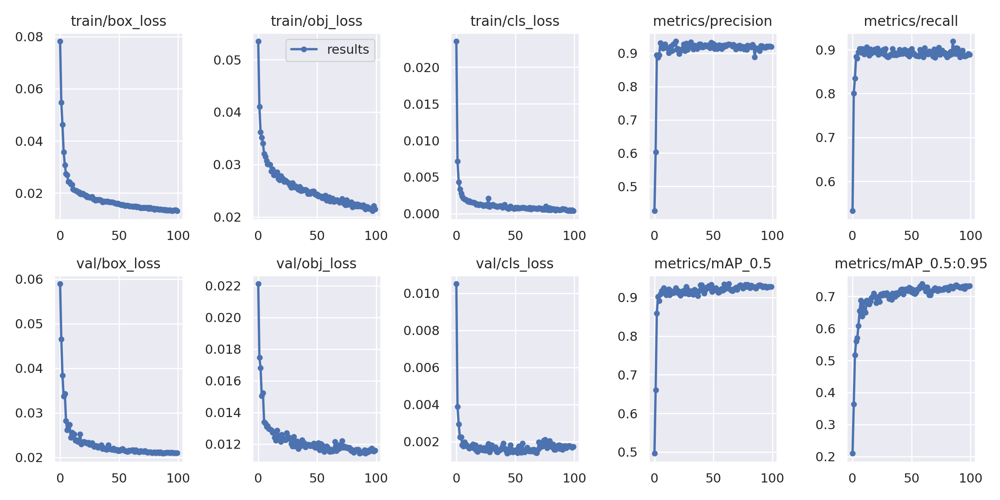

In [10]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/exp2/results.png', width=1000)  # view results.png

GROUND TRUTH TRAINING DATA:


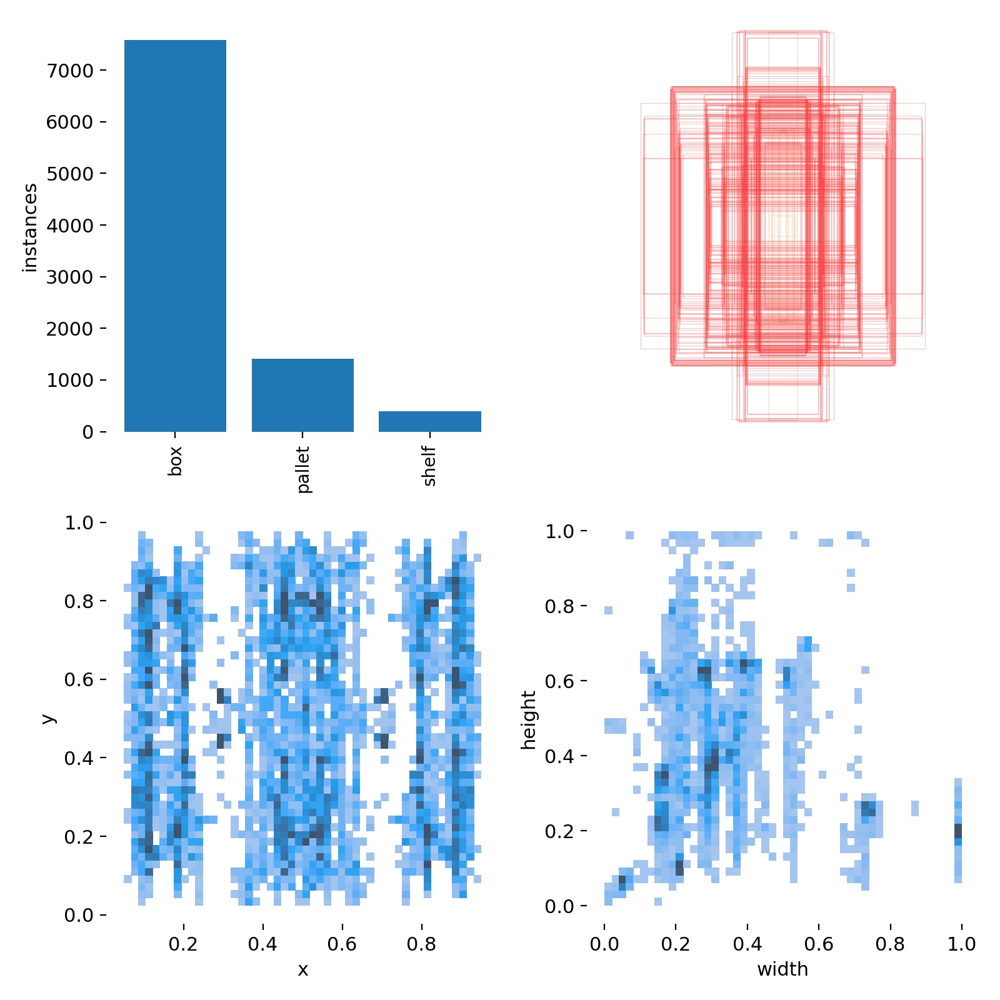

In [12]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/exp/labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


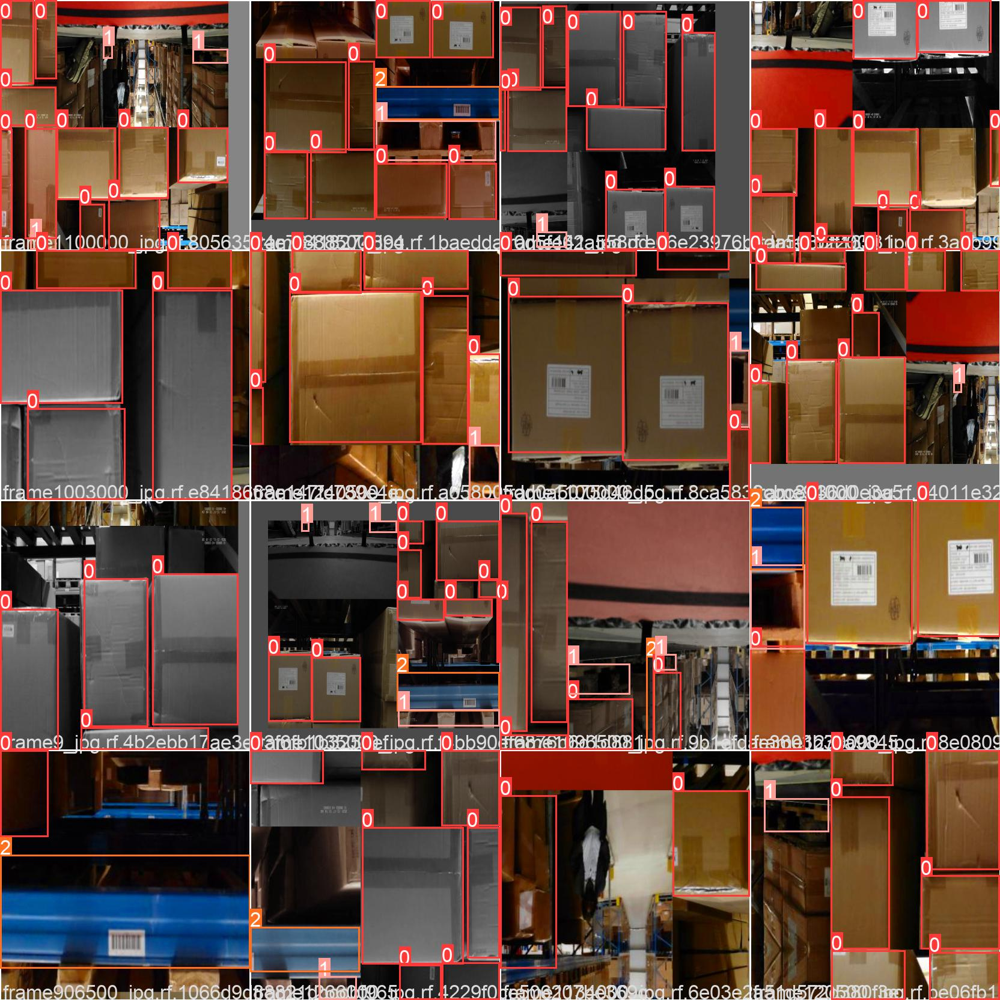

In [14]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/exp/train_batch0.jpg', width=900)

In [15]:
# trained weights are saved by default in our weights folder
%ls runs/

train/


In [16]:
%ls runs/train/yolov5s_results/weights

ls: cannot access 'runs/train/yolov5s_results/weights': No such file or directory


In [19]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/train/exp2/weights/best.pt --img 416 --conf 0.4 --source /content/datasets/object_dtect-1/test/images

/content/yolov5
detect: weights=['runs/train/exp2/weights/best.pt'], source=/content/datasets/object_dtect-1/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-14-g8a66eba torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/105 /content/datasets/object_dtect-1/test/images/frame1008500_jpg.rf.5aa5aa3eb3606977d3116bcc5a17c120.jpg: 416x416 5 boxs, Done. (0.014s)
image 2/105 /content/datasets/object_dtect-1/test/images/frame1011000_jpg.rf.fede976db6ab631d85529d6566762f43.jpg: 416x416 6 boxs, Done. (0.016s)
image 3/105 /content/datasets/object_dtect

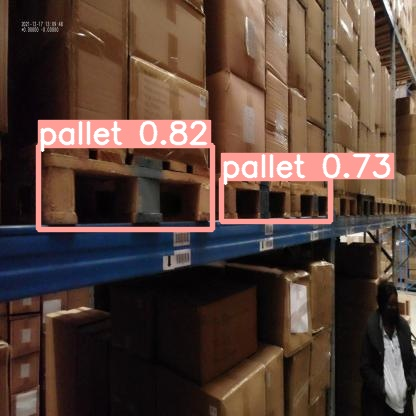

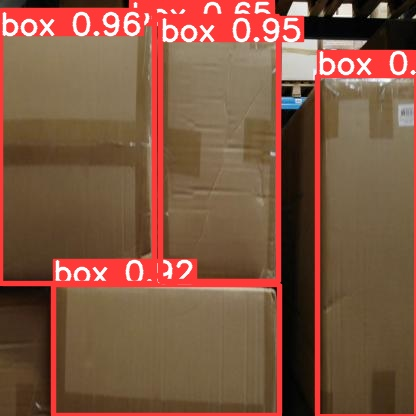

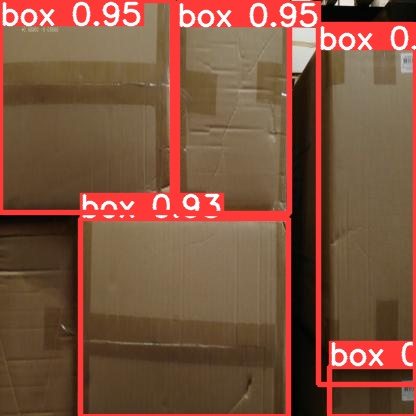

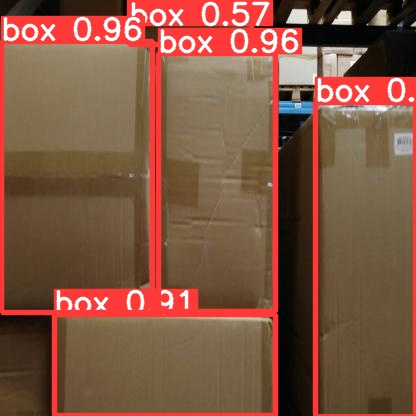

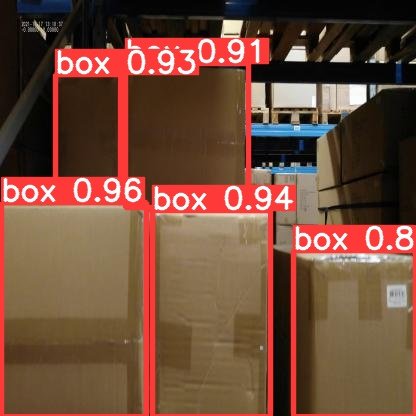

...

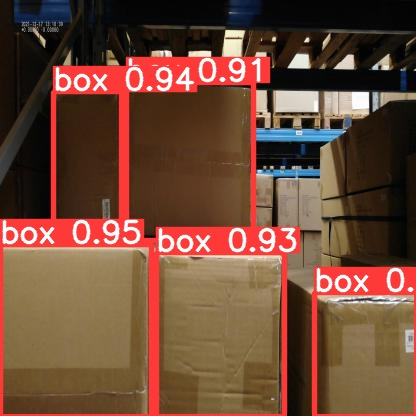

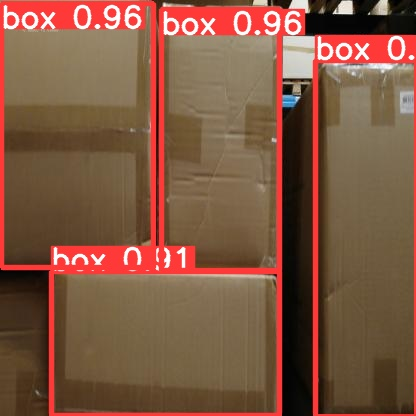

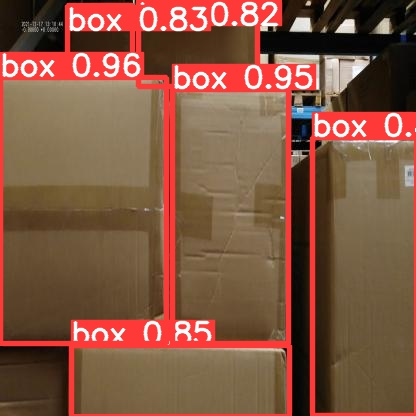

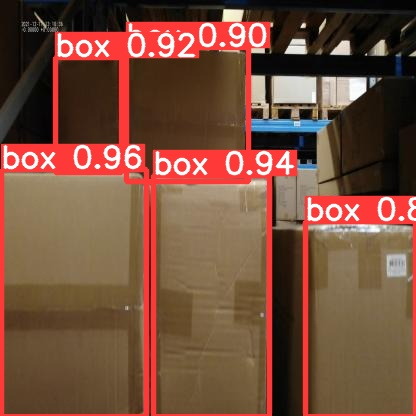

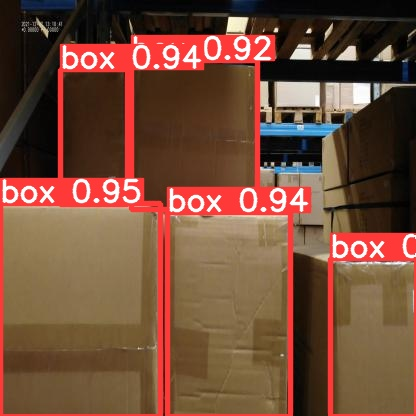

In [20]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp3/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [21]:
# !python detect.py --weights runs/train/exp/weights/best.pt --conf 0.1 --source /content/datasets/object_dtect-1/test/DJI_0458.MP4

!python detect.py --weights runs/train/exp2/weights/best.pt --img 416 --conf 0.4 --source /content/datasets/object_dtect-1/test/img


detect: weights=['runs/train/exp2/weights/best.pt'], source=/content/datasets/object_dtect-1/test/img, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-14-g8a66eba torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/6 /content/datasets/object_dtect-1/test/img/frame2315000.jpg: 256x416 3 boxs, 2 shelfs, Done. (0.021s)
image 2/6 /content/datasets/object_dtect-1/test/img/frame2475500.jpg: 256x416 4 boxs, Done. (0.012s)
image 3/6 /content/datasets/object_dtect-1/test/img/frame3632000.jpg: 256x416 1 pallet, Done. (0.012s)
image 4/6 /content/datasets/object_dte

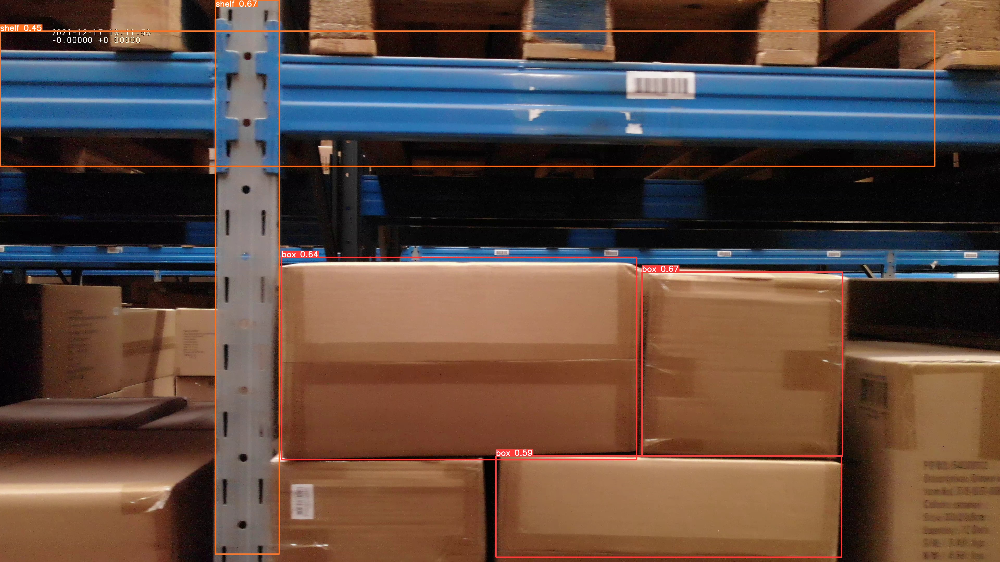

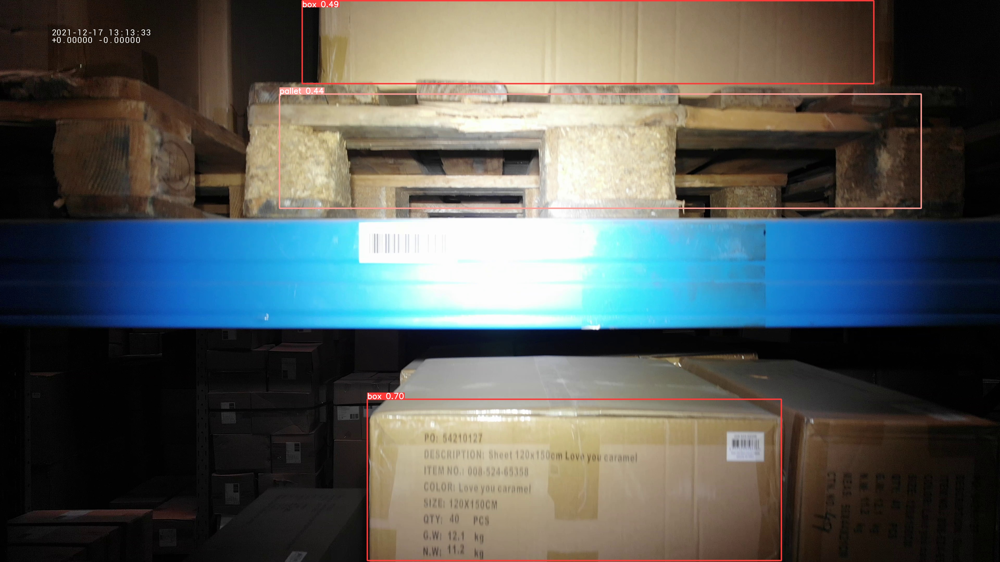

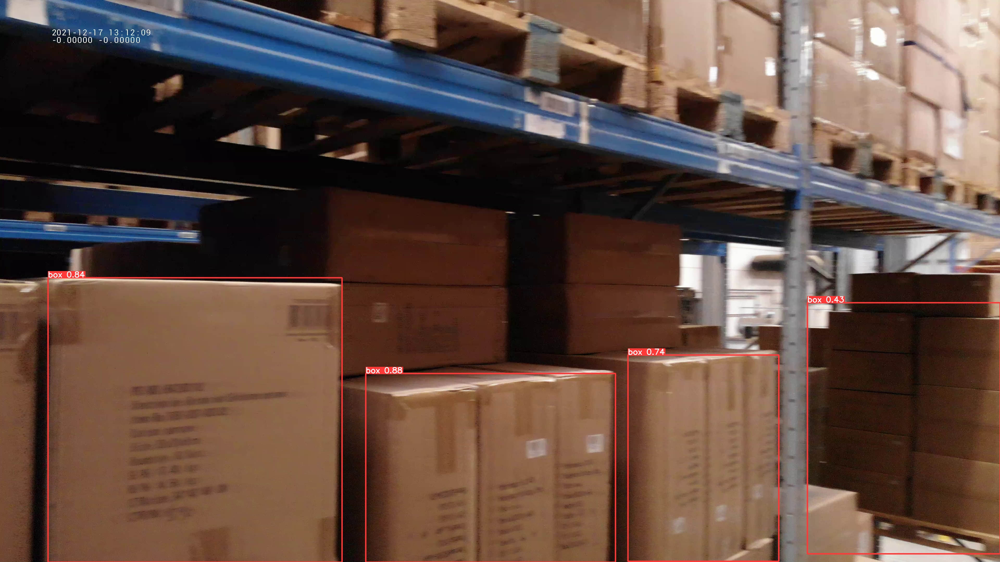

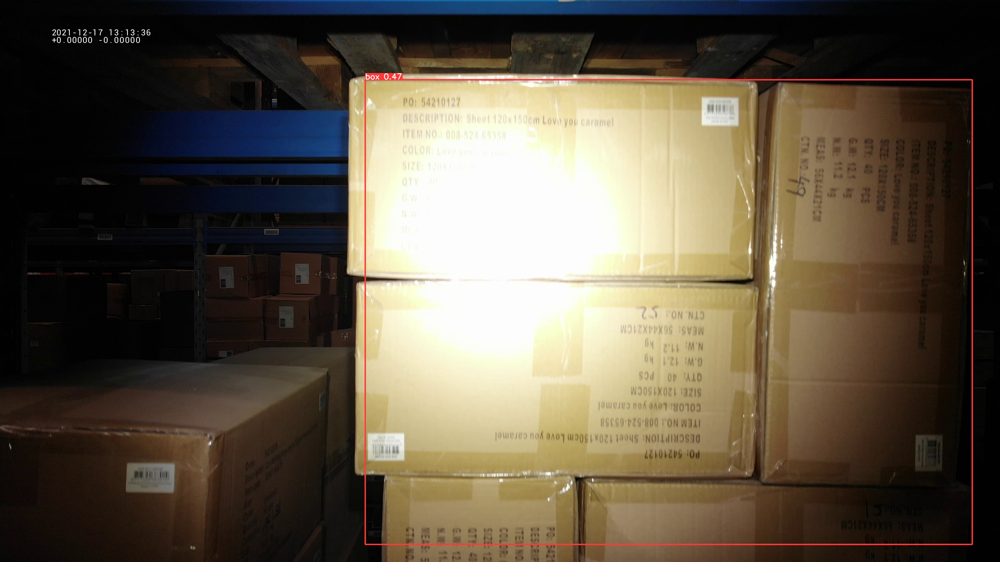

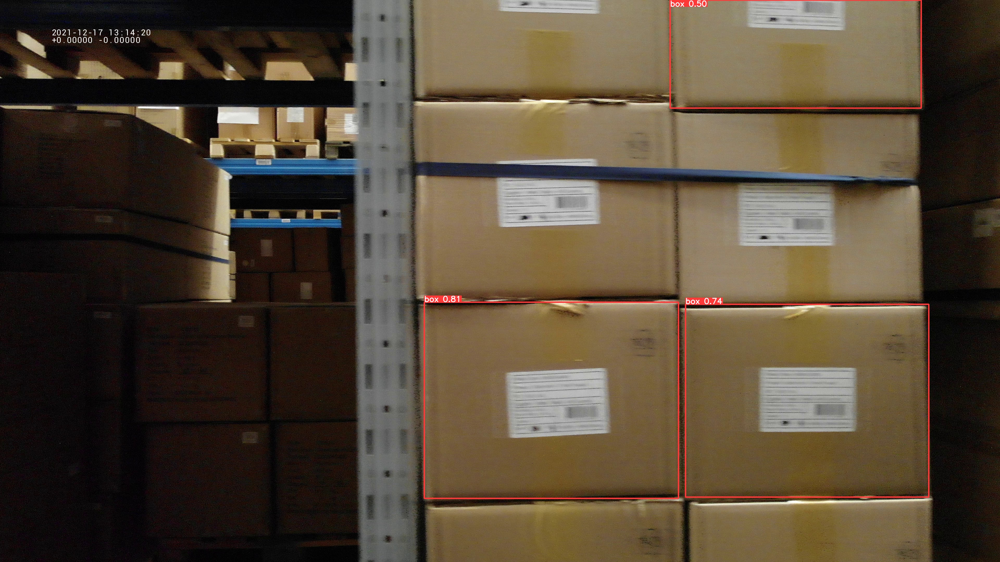

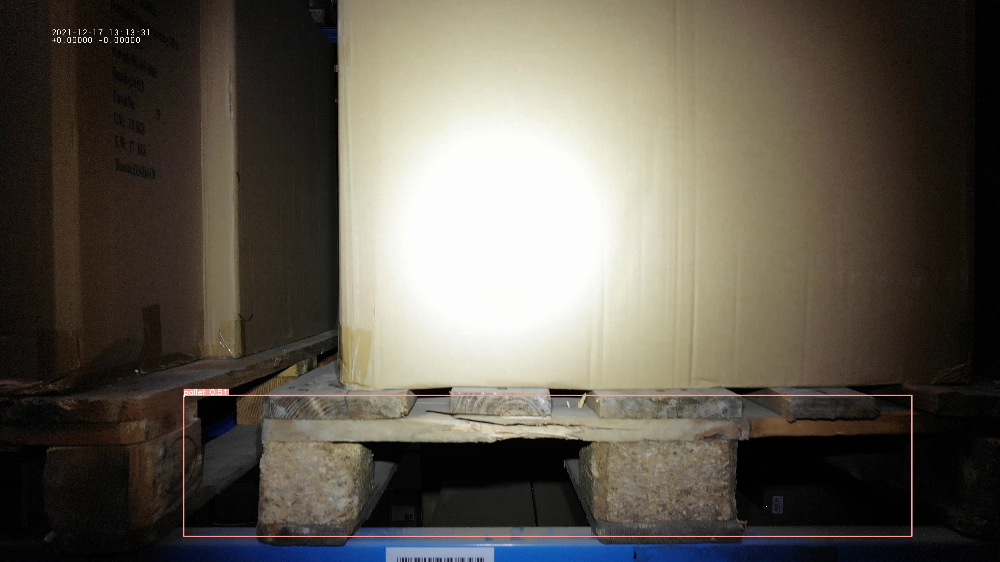

In [23]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp4/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [24]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !pip install -U tensorboard

# For help, run "tensorboard dev --help" or "tensorboard dev COMMAND --help"

# # Upload an experiment:
# ! tensorboard dev upload --logdir runs \
#     --name "(optional) My latest experiment" \
#     --description "(optional) Simple comparison of several hyperparameters"


# Start tensorboard
# # Launch after you have started training
# # logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs
